In [72]:
import os

from tqdm import tqdm

import itertools
import warnings
warnings.filterwarnings('ignore')

from matplotlib import gridspec
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
from matplotlib import cm
import matplotlib.ticker as mtick
from matplotlib.ticker import MaxNLocator


import datetime
from scipy import stats
from scipy.stats import pearsonr
import statsmodels.api as sm

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data_path = '/Users/reneprincipe/Library/CloudStorage/GoogleDrive-rlprincipe@up.edu.ph/My Drive/Research - PhD/Results/Resettlements/Resettlement Black Marble NTL Values/' 

In [3]:
start_date, end_date = "2012-01-01", "2024-01-28"
date_range = pd.date_range(start=start_date, end=end_date, freq='D')

In [4]:
files = [f for f in os.listdir(data_path) if not f.startswith('.')]
files.sort()
files

['NTL_Resettlement_Sites_0.csv',
 'NTL_Resettlement_Sites_1.csv',
 'NTL_Resettlement_Sites_2.csv',
 'NTL_Resettlement_Sites_3.csv',
 'NTL_Resettlement_Sites_4.csv',
 'NTL_Resettlement_Sites_5.csv']

# Test Plots

In [5]:
NTL_data = pd.read_csv(data_path+files[0], parse_dates=True, index_col = 0)*10#.reset_index(drop=True)*10
NTL_data.astype(float)

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Carigara Housing Project 1,Ecoville,Vergabriel's Heights,Mayorga Towne Homes,Paglaum Ville,Mont Eagle Ville IV,Tolosa Haiyan Village,Matlang Heights,Coconut Grove,Bagong Pag-Asa
2012-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,0.0,7.000000,0.000000,0.000000,0.000000,0.000000,8.719577,...,16.0,5.489796,5.793893,0.0,3.0,0.000000,7.480916,15.341969,0.0,8.424138
2024-01-25,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,13.0,10.061224,2.320611,2.0,3.0,1.574219,5.076336,27.575130,3.0,9.724138
2024-01-26,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,13.0,10.061224,2.320611,2.0,3.0,1.574219,5.076336,27.575130,3.0,9.724138
2024-01-27,30.448276,7.952381,8.851852,11.0,11.168675,4.123188,4.296296,5.182857,4.217391,10.211640,...,13.0,10.061224,2.320611,2.0,3.0,5.128906,5.076336,14.611399,3.0,9.724138


## formatter functions

In [6]:
def format_dates():
    dtFmt = mdates.DateFormatter("%b-%Y") # define the formatting
    ax.xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis
    plt.gcf().autofmt_xdate
    
def show_legend():    
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)
    plt.legend(fontsize=10, ncol = 3, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
                    bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand')

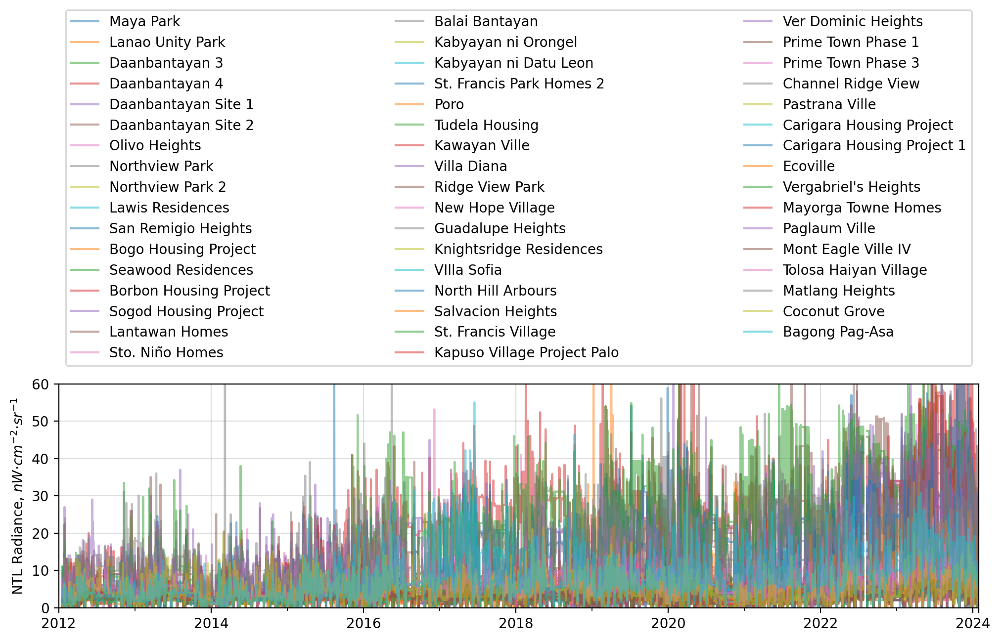

In [7]:
fig, ax = plt.subplots(dpi = 200, figsize = (12,3))
fig.patch.set_facecolor('None')

NTL_data.plot(ax=ax, alpha = 0.5)
show_legend()
plt.ylim(0,60)
plt.show()

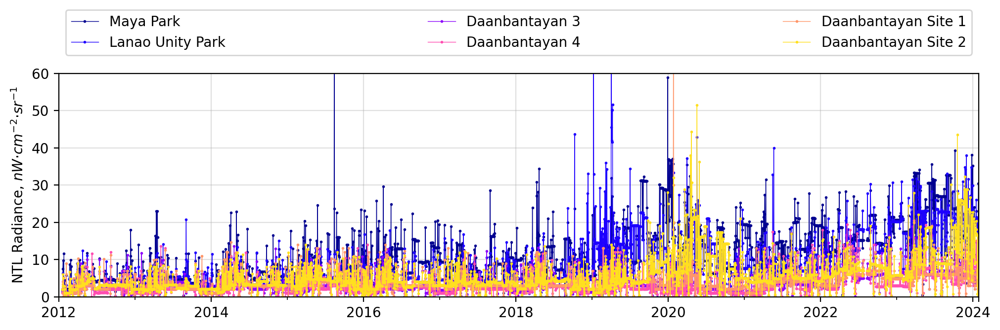

In [8]:
NTL_test = NTL_data[NTL_data.columns[:6]]
palette = sns.color_palette('gnuplot2', len(NTL_test.columns))


fig, ax = plt.subplots(dpi = 200, figsize = (12,3))
fig.patch.set_facecolor('None')

NTL_test.plot(ax=ax, marker='o', markersize=1, linestyle='-', linewidth=0.5, color = palette)
ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
show_legend()
plt.ylim(0,60)
plt.show()

## quantile filtering

In [16]:
def outlier_removal(dataframe):
    q_low = dataframe.quantile(0.05)
    q_hi  = dataframe.quantile(0.95)
    dataframe = dataframe[(dataframe < q_hi) & (dataframe > q_low)]
    return dataframe

cleaned = outlier_removal(NTL_test)

## interpolating NAN values

In [17]:
NTL_test_processed = cleaned.interpolate(method='linear', limit_direction='both')
NTL_test_processed

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2
2012-01-01,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-02,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-03,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-04,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-05,7.505747,6.313492,1.226852,1.0,2.0,1.876812
...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,6.0,7.0,5.109601
2024-01-25,19.293103,21.130952,4.435185,6.0,3.0,4.780797
2024-01-26,19.293103,21.130952,4.435185,6.0,3.0,4.451993
2024-01-27,19.293103,7.952381,4.435185,6.0,3.0,4.123188


# Visualizing NTL data

In [18]:
def visualize_ts(dataframe):
    fig, ax = plt.subplots(dpi = 200, figsize = (12,4))
    fig.patch.set_facecolor('None')
    
    palette = sns.color_palette('gnuplot2', len(dataframe.columns))

    dataframe.plot(ax=ax, marker='o', markersize=1, linestyle='-', linewidth=0.5, color = palette)
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)
    plt.legend(fontsize=8, ncol = 3, bbox_to_anchor= (0, .85, 0.5, 0.5), loc="lower left",
                    bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand')

    plt.ylim(0,30)
#     plt.show()

Text(0.5, 1.0, 'Preprocessed Black Marble NTL')

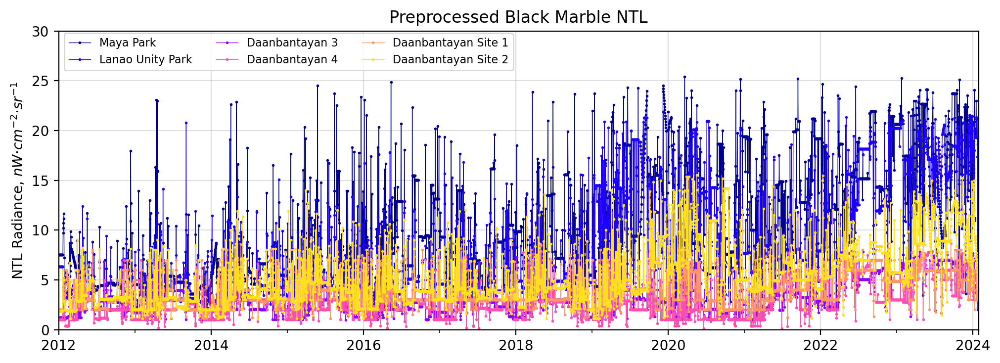

In [19]:
visualize_ts(NTL_test_processed)
plt.title("Preprocessed Black Marble NTL")

## moving average

Text(0.5, 1.0, 'Moving Average (365 days)')

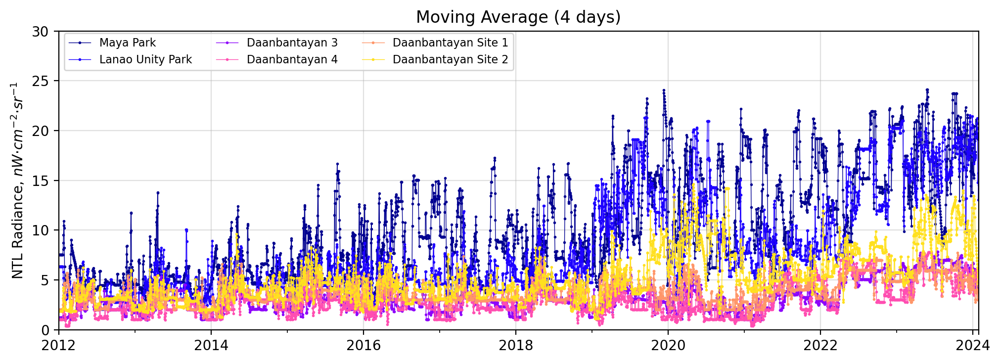

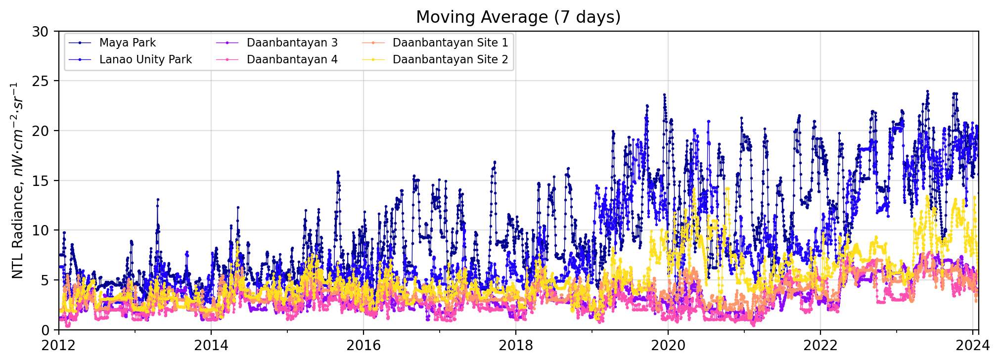

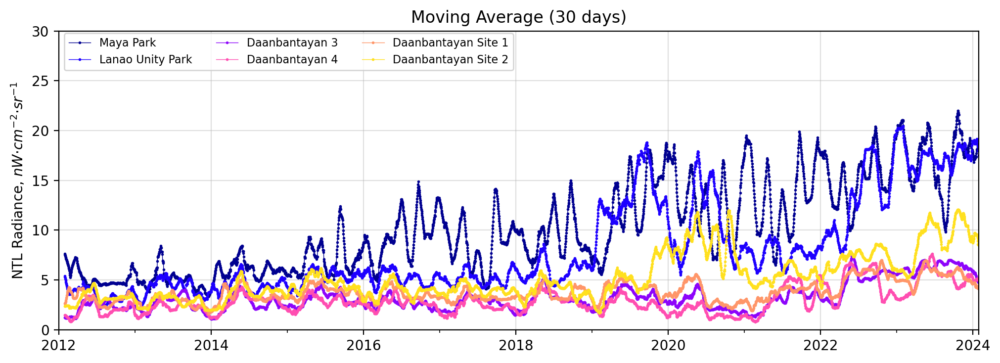

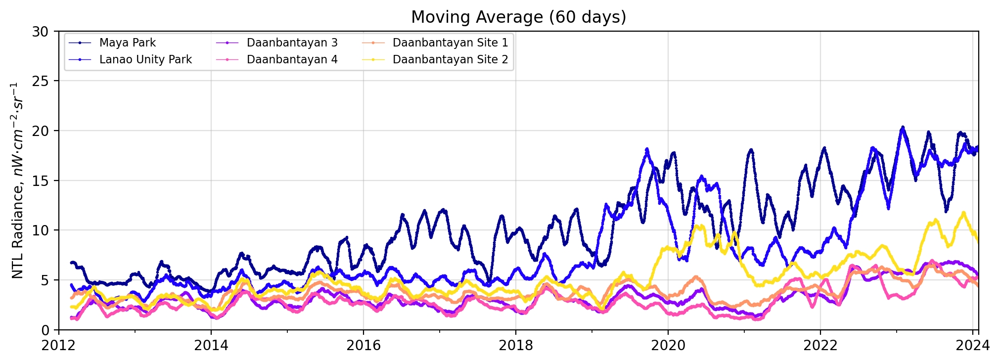

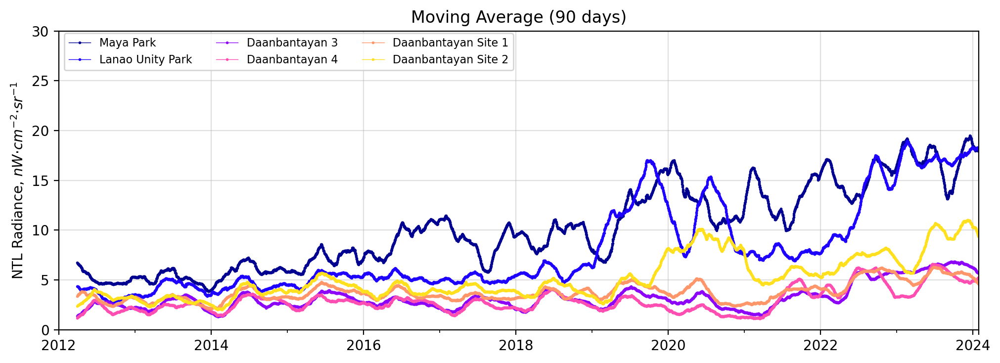

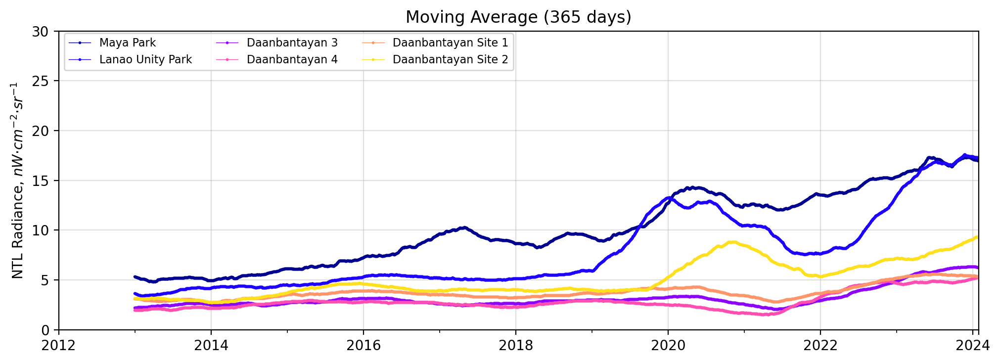

In [20]:

visualize_ts(NTL_test_processed.rolling(4).mean())
plt.title("Moving Average (4 days)")
visualize_ts(NTL_test_processed.rolling(7).mean())
plt.title("Moving Average (7 days)")
visualize_ts(NTL_test_processed.rolling(30).mean())
plt.title("Moving Average (30 days)")
visualize_ts(NTL_test_processed.rolling(60).mean())
plt.title("Moving Average (60 days)")
visualize_ts(NTL_test_processed.rolling(90).mean())
plt.title("Moving Average (90 days)")
visualize_ts(NTL_test_processed.rolling(365).mean())
plt.title("Moving Average (365 days)")

# Loading Resettlement Database

In [21]:
path = '/Users/reneprincipe/Library/CloudStorage/GoogleDrive-rlprincipe@up.edu.ph/My Drive/Research - PhD/Results/'

In [22]:
df = pd.read_excel(path + 'Philippine Resettlement Sites Database - RPrincipe et al. (2023).xlsx')

df['Latitude'] = pd.to_numeric(df['Latitude'], errors='coerce')
df['Longitude'] = pd.to_numeric(df['Longitude'], errors='coerce')
df['Buffer'] = pd.to_numeric(df['Buffer'], errors='coerce')
df = df[df['Buffer'].notna()].reset_index()
df_resettlement = df.copy()
# df_resettlement_ = df_resettlement
df_resettlement.head()

,index,Calamity,Project Name,Location,Classification,Latitude,Longitude,Buffer,Title,Map URL,Remarks,External Links,External Links.1,Typhoon,Province,Group
0,0,Typhoon Yolanda (2013),Maya Park Homes,"Brgy. Maya, Daanbantayan, Cebu",Identified,11.271009,124.048967,230.0,Maya Park,https://goo.gl/maps/3L3eRoigGDpjMxHT8,NaN,NaN,https://newsinfo.inquirer.net/944060/poor-nha-...,Yolanda,Cebu,Cebu
1,1,Typhoon Yolanda (2013),Lanao Unity Park Homes,"Brgy. Lanao, Daanbantayan, Cebu",Identified,11.248469,124.022224,280.0,Lanao Unity Park,https://goo.gl/maps/5SZCHBveYJqorcZ87,NaN,https://daanbantayan.gov.ph/2022/04/04/lanao-u...,NaN,Yolanda,Cebu,Cebu
2,2,Typhoon Yolanda (2013),Green Heights 1 (Daanbantayan 3),"Brgy. Tominjao, Daanbantayan, Cebu",Probable,11.221464,124.036788,260.0,Daanbantayan 3,https://goo.gl/maps/gjzeHfJ73dMTdiuX8,NaN,NaN,NaN,Yolanda,Cebu,Cebu
3,3,Typhoon Yolanda (2013),Green Heights 2 (Daanbantayan 4),"Brgy. Tominjao, Daanbantayan, Cebu",Identified,11.173075,124.015380,160.0,Daanbantayan 4,https://goo.gl/maps/1PfPDyVLY4bHvp78A,Adress was wrong on the NHA list. Turn-over da...,https://www.facebook.com/photo/?fbid=165837642...,NaN,Yolanda,Cebu,Cebu
4,4,Typhoon Yolanda (2013),Kandaya Homes 1 (Daanbantayan Site 1),"Brgy. Tapilon, Daanbantayan Site 1, Cebu",Identified,11.260164,124.036611,160.0,Daanbantayan Site 1,https://goo.gl/maps/2esB7Pmhx5NuNjYYA,Sites were raffled off to beneficiaries. Shape...,https://www.facebook.com/DaanbantayanLGU/photo...,https://www.facebook.com/DaanbantayanLGU/photo...,Yolanda,Cebu,Cebu


# Loading NTL dataframes

In [23]:
NTL_dataframe = pd.DataFrame(index = date_range)
for i, file in tqdm(enumerate(files)):
    NTL_data = pd.read_csv(data_path+file, index_col = 0, parse_dates=True)#.reset_index(drop=True)
    NTL_dataframe = pd.concat([NTL_dataframe, NTL_data*10], axis = 1)
    
NTL_dataframe

6it [00:00, 33.49it/s]


,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Southville 9,Northville 2A,Dinalungan Heights,San Luis Villas,Dinalungan Res,Tuba Res,Badat,Binudac,Galoc,Balud
2012-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,0.0,7.000000,0.000000,0.000000,0.000000,0.000000,8.719577,...,38.132132,139.622951,0.396947,2.0,0.396947,38.132132,3.769231,0.0,0.760976,1.0
2024-01-25,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0
2024-01-26,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,40.548048,180.573770,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0
2024-01-27,30.448276,7.952381,8.851852,11.0,11.168675,4.123188,4.296296,5.182857,4.217391,10.211640,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0


In [39]:
def outlier_removal(dataframe):
    # Create an empty DataFrame to store the cleaned data
    cleaned_data = pd.DataFrame(index = date_range)

    # Iterate through each column
    for col in dataframe.columns:
        # Calculate column-specific quantiles
        q_low = dataframe[col].quantile(0.05)
        q_hi = dataframe[col].quantile(0.95)

        # Apply the condition to the column
        cleaned_col = dataframe[(dataframe[col] >= q_low) & (dataframe[col] <= q_hi)][col]

        # Add the cleaned column to the new DataFrame
        cleaned_data[col] = cleaned_col

    return cleaned_data

In [40]:
NTL_dataframe = outlier_removal(NTL_dataframe)
NTL_dataframe = NTL_dataframe.interpolate(method='linear', limit_direction='both')
NTL_dataframe

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Southville 9,Northville 2A,Dinalungan Heights,San Luis Villas,Dinalungan Res,Tuba Res,Badat,Binudac,Galoc,Balud
2012-01-01,7.505747,6.313492,1.226852,1.0,2.0,2.876812,2.000000,2.771429,1.652174,5.015873,...,16.710210,98.000000,0.603053,1.0,0.603053,16.710210,0.000000,0.4375,0.336585,0.173913
2012-01-02,7.505747,6.313492,1.226852,1.0,2.0,2.876812,2.000000,2.771429,1.652174,5.015873,...,16.710210,98.000000,0.603053,1.0,0.603053,16.710210,0.000000,0.4375,0.336585,0.173913
2012-01-03,7.505747,6.313492,1.226852,1.0,2.0,2.876812,2.000000,2.771429,1.652174,5.015873,...,16.710210,98.000000,0.603053,1.0,0.603053,16.710210,0.000000,0.4375,0.336585,0.173913
2012-01-04,7.505747,6.313492,1.226852,1.0,2.0,2.876812,2.000000,2.771429,1.652174,5.015873,...,16.710210,98.000000,0.603053,1.0,0.603053,16.710210,0.000000,0.4375,0.336585,0.173913
2012-01-05,7.505747,6.313492,1.226852,1.0,2.0,2.876812,2.000000,2.771429,1.652174,5.015873,...,16.710210,98.000000,0.603053,1.0,0.603053,16.710210,0.000000,0.4375,0.336585,0.173913
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,15.928571,2.208333,0.0,7.0,5.109601,2.462963,5.182857,4.691304,7.000000,...,38.132132,139.622951,1.000000,2.0,1.000000,38.132132,3.769231,0.0000,0.760976,1.000000
2024-01-25,19.293103,13.269841,4.435185,6.0,3.0,4.780797,4.296296,5.182857,2.956522,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0000,1.921951,1.000000
2024-01-26,19.293103,10.611111,4.435185,6.0,3.0,4.451993,4.296296,5.182857,2.956522,7.000000,...,40.548048,180.573770,1.000000,2.0,1.000000,40.548048,1.000000,1.0000,1.921951,1.000000
2024-01-27,19.293103,7.952381,4.435185,6.0,3.0,4.123188,4.296296,5.182857,4.217391,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0000,1.921951,1.000000


In [41]:
period = 365
trend = NTL_dataframe.copy()
seasonality = NTL_dataframe.copy()
residual = NTL_dataframe.copy()

for loc in tqdm(NTL_dataframe.columns, desc = 'STL Decomposition'):
    data = NTL_dataframe[loc].values
    decomposition = sm.tsa.seasonal_decompose(data, model='additive', period = period)
    trend[loc] = decomposition.trend
    seasonality[loc] = decomposition.seasonal
    residual[loc] = decomposition.resid

NTL_STL = pd.concat([NTL_dataframe,trend, seasonality, residual], axis = 1, keys = ['Raw', 'Trend', 'Seasonality', 'Residual'])
NTL_STL

STL Decomposition: 100%|█████████████████████| 267/267 [00:02<00:00, 110.66it/s]


Raw                                                 \
            Maya Park Lanao Unity Park Daanbantayan 3 Daanbantayan 4   
2012-01-01   7.505747         6.313492       1.226852            1.0   
2012-01-02   7.505747         6.313492       1.226852            1.0   
2012-01-03   7.505747         6.313492       1.226852            1.0   
2012-01-04   7.505747         6.313492       1.226852            1.0   
2012-01-05   7.505747         6.313492       1.226852            1.0   
...               ...              ...            ...            ...   
2024-01-24  18.637931        15.928571       2.208333            0.0   
2024-01-25  19.293103        13.269841       4.435185            6.0   
2024-01-26  19.293103        10.611111       4.435185            6.0   
2024-01-27  19.293103         7.952381       4.435185            6.0   
2024-01-28  19.293103         7.952381       4.435185            6.0   

                                                                  \
           Daanbantayan Site 1 Daanbantayan Site 2 Olivo Heights   
2012-01-01                 2.0            2.876812      2.000000   
2012-01-02                 2.0            2.876812      2.000000   
2012-01-03                 2.0            2.876812      2.000000   
2012-01-04                 2.0            2.876812      2.000000   
2012-01-05                 2.0            2.876812      2.000000   
...                        ...                 ...           ...   
2024-01-24                 7.0            5.109601      2.462963   
2024-01-25                 3.0            4.780797      4.296296   
2024-01-26                 3.0            4.451993      4.296296   
2024-01-27                 3.0            4.123188      4.296296   
2024-01-28                 3.0            4.123188      4.296296   

                                                              ...  \
           Northview Park Northview Park 2 Lawis Residences   ...   
2012-01-01       2.771429         1.652174          5.015873  ...   
2012-01-02       2.771429         1.652174          5.015873  ...   
2012-01-03       2.771429         1.652174          5.015873  ...   
2012-01-04       2.771429         1.652174          5.015873  ...   
2012-01-05       2.771429         1.652174          5.015873  ...   
...                   ...              ...               ...  ...   
2024-01-24       5.182857         4.691304          7.000000  ...   
2024-01-25       5.182857         2.956522          7.000000  ...   
2024-01-26       5.182857         2.956522          7.000000  ...   
2024-01-27       5.182857         4.217391          7.000000  ...   
2024-01-28       5.182857         4.217391          7.000000  ...   

               Residual                                                   \
           Southville 9 Northville 2A Dinalungan Heights San Luis Villas   
2012-01-01          NaN           NaN                NaN             NaN   
2012-01-02          NaN           NaN                NaN             NaN   
2012-01-03          NaN           NaN                NaN             NaN   
2012-01-04          NaN           NaN                NaN             NaN   
2012-01-05          NaN           NaN                NaN             NaN   
...                 ...           ...                ...             ...   
2024-01-24          NaN           NaN                NaN             NaN   
2024-01-25          NaN           NaN                NaN             NaN   
2024-01-26          NaN           NaN                NaN             NaN   
2024-01-27          NaN           NaN                NaN             NaN   
2024-01-28          NaN           NaN                NaN             NaN   

                                                              
           Dinalungan Res Tuba Res Badat Binudac Galoc Balud  
2012-01-01            NaN      NaN   NaN     NaN   NaN   NaN  
2012-01-02            NaN      NaN   NaN     NaN   NaN   NaN  
2012-01-03            NaN      NaN   NaN     NaN   NaN   

In [42]:
def visualize_ts(dataframe):
    fig, ax = plt.subplots(dpi = 200, figsize = (12,8))
    fig.patch.set_facecolor('None')

    palette = sns.color_palette('Spectral', len(NTL_mov_ave.columns))

    dataframe.plot(ax=ax, marker='o', markersize=0.2, linestyle='-', alpha = 0.5,
                     linewidth=0.2, color = palette, legend=False)
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)

Text(0.5, 1.0, 'NTL Residual')

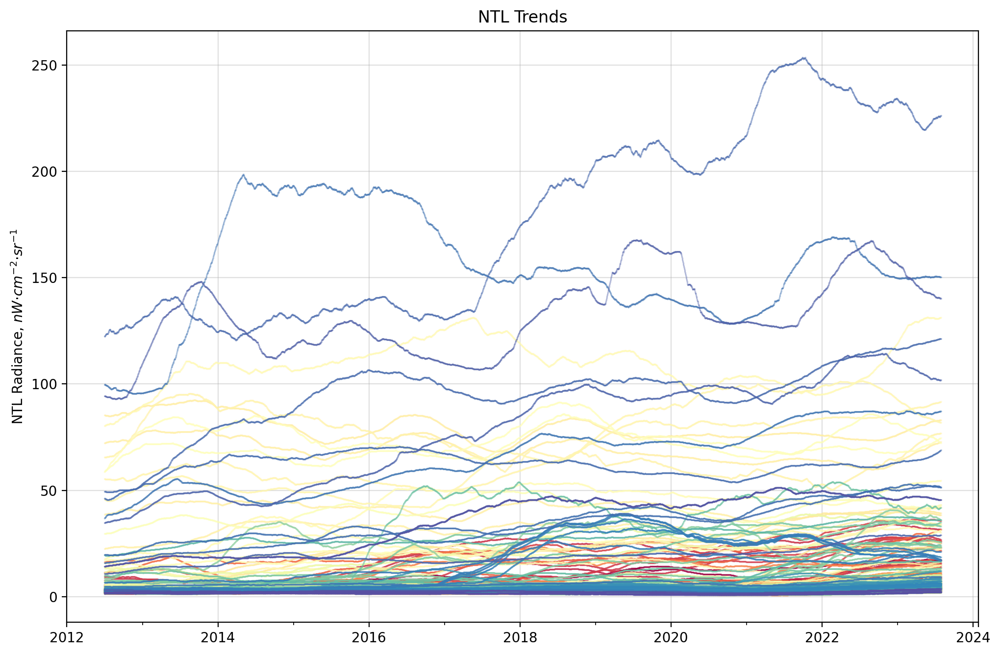

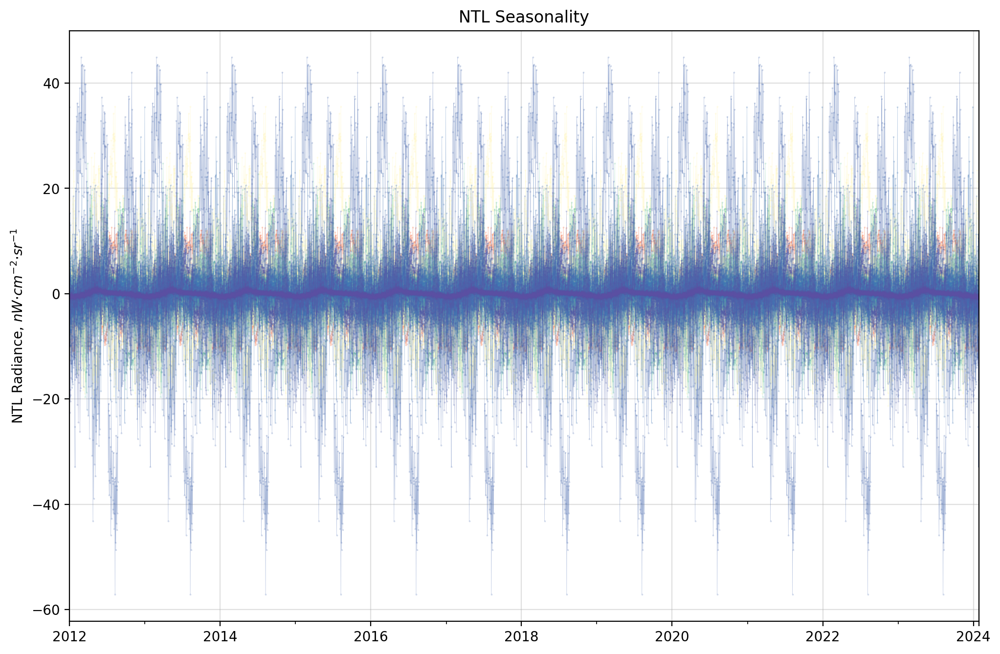

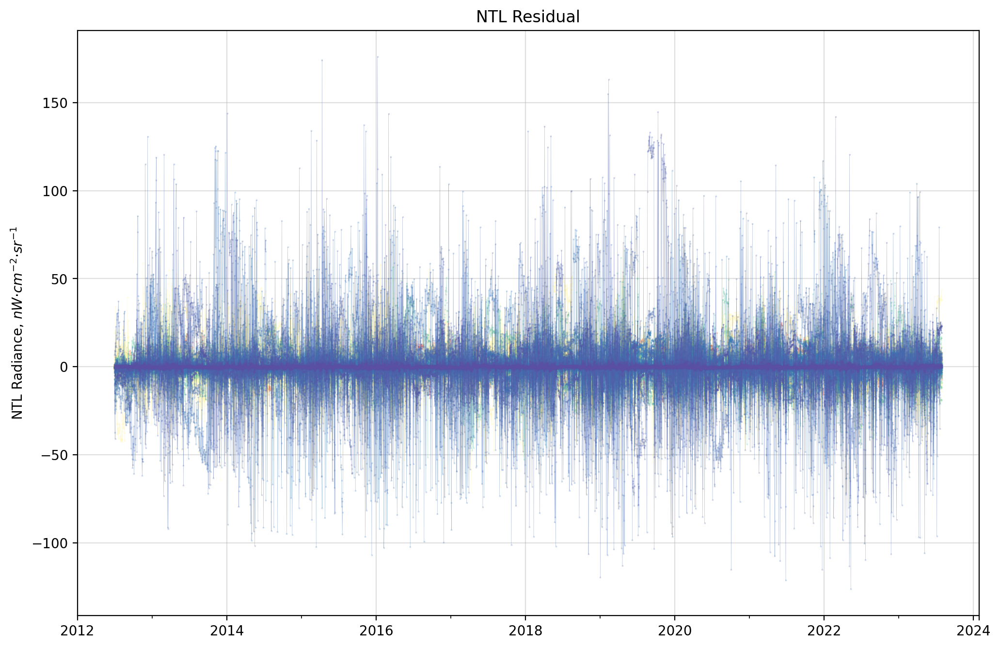

In [38]:
visualize_ts(NTL_STL['Trend'])
plt.title('NTL Trends')
visualize_ts(NTL_STL['Seasonality'])
plt.title('NTL Seasonality')
visualize_ts(NTL_STL['Residual'])
plt.title('NTL Residual')

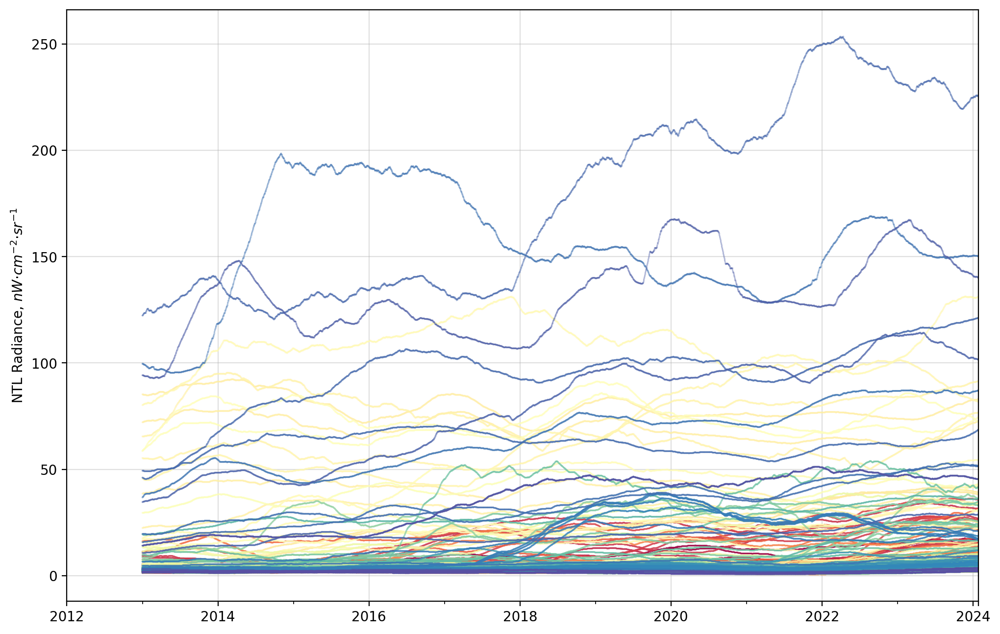

In [26]:
NTL_mov_ave = NTL_dataframe.rolling(365).mean()

fig, ax = plt.subplots(dpi = 200, figsize = (12,8))
fig.patch.set_facecolor('None')

palette = sns.color_palette('Spectral', len(NTL_mov_ave.columns))

NTL_mov_ave.plot(ax=ax, marker='o', markersize=0.2, linestyle='-', alpha = 0.5,
                 linewidth=0.2, color = palette, legend=False)
ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
ax.grid(alpha = 0.4)
# plt.yscale('log')
# plt.ylim(0,30)

In [45]:
province = 'Cebu'
sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].unique()
NTL_mov_ave[sites]

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Borbon Housing Project,Sogod Housing Project,Lantawan Homes,Sto. Niño Homes,Balai Bantayan,Kabyayan ni Orongel,Kabyayan ni Datu Leon,St. Francis Park Homes 2,Poro,Tudela Housing
2012-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,16.993038,17.236586,6.260389,5.248086,5.325212,9.292068,5.916919,7.158165,4.594078,6.577049,...,2.732667,4.322831,4.164759,15.602118,7.503843,7.101052,8.839488,3.275156,3.577872,14.209182
2024-01-25,16.987023,17.236945,6.254187,5.256305,5.319732,9.289403,5.914179,7.158290,4.592578,6.584485,...,2.732667,4.317352,4.155212,15.602839,7.507811,7.102865,8.840420,3.270548,3.572393,14.182496
2024-01-26,16.981008,17.237304,6.247984,5.264525,5.314253,9.285837,5.911439,7.158415,4.591077,6.591921,...,2.732667,4.311872,4.145664,15.603560,7.511780,7.104677,8.841351,3.265940,3.575133,14.155809
2024-01-27,16.974993,17.201557,6.241782,5.272744,5.308773,9.281370,5.908700,7.158541,4.593030,6.599358,...,2.732667,4.306393,4.136117,15.606684,7.515748,7.106490,8.842283,3.261333,3.580524,14.129123


In [92]:
NTL_STL['Raw'].iloc[:,I]

NameError: name 'I' is not defined

In [ ]:
NTL_mov_ave[sites]

In [89]:
results_path = '/Users/reneprincipe/Library/CloudStorage/GoogleDrive-rlprincipe@up.edu.ph/My Drive/Research - PhD/Results/Plots/' 

In [96]:
NTL_STL['Raw']['Maya Park']

2012-01-01     7.505747
2012-01-02     7.505747
2012-01-03     7.505747
2012-01-04     7.505747
2012-01-05     7.505747
                ...    
2024-01-24    18.637931
2024-01-25    19.293103
2024-01-26    19.293103
2024-01-27    19.293103
2024-01-28    19.293103
Freq: D, Name: Maya Park, Length: 4411, dtype: float64

In [98]:
provinces

array(['Cebu', 'Leyte', 'Samar', 'Biliran', 'Compostella Valley',
       'Davao Oriental', 'Compostela', 'Misamis Oriental',
       'Lanao Del Norte', 'Albay', 'Camarines Sur', 'Catanduanes',
       'Aklan', 'Antique', 'Capiz', 'Negros Occidental',
       'Negros Oriental', 'Iloilo', 'Bulacan', 'Laguna', 'Rizal', 'NCR',
       'Aurora', 'Benguet', 'Palawan'], dtype=object)

  0%|                                                    | 0/25 [00:00<?, ?it/s]

Processing Cebu
Processing Maya Park
Processing Lanao Unity Park
Processing Daanbantayan 3
Processing Daanbantayan 4
Processing Daanbantayan Site 1
Processing Daanbantayan Site 2
Processing Olivo Heights
Processing Northview Park
Processing Northview Park 2
Processing Lawis Residences 
Processing San Remigio Heights
Processing Bogo Housing Project
Processing Seawood Residences
Processing Borbon Housing Project
Processing Sogod Housing Project
Processing Lantawan Homes 
Processing Sto. Niño Homes
Processing Balai Bantayan
Processing Kabyayan ni Orongel
Processing Kabyayan ni Datu Leon
Processing St. Francis Park Homes 2
Processing Poro
Processing Tudela Housing


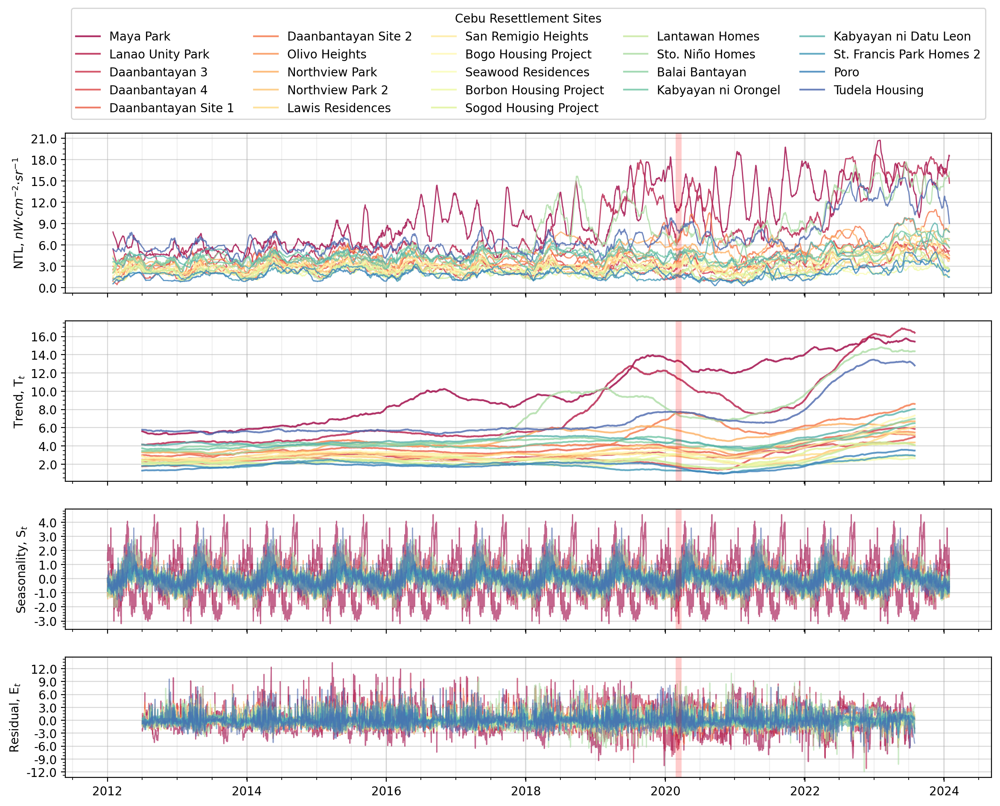

  4%|█▊                                          | 1/25 [00:04<01:42,  4.28s/it]

Processing Leyte
Processing Kawayan Ville
Processing Villa Diana
Processing Ridge View Park
Processing New Hope Village
Processing Guadalupe Heights
Processing Knightsridge Residences
Processing VIlla Sofia
Processing North Hill Arbours
Processing Salvacion Heights
Processing St. Francis Village
Processing Kapuso Village Project Palo
Processing Ver Dominic Heights
Processing Prime Town Phase 1
Processing Prime Town Phase 3
Processing Channel Ridge View
Processing Pastrana Ville
Processing Carigara Housing Project
Processing Carigara Housing Project 1
Processing Ecoville
Processing Vergabriel's Heights
Processing Mayorga Towne Homes
Processing Paglaum Ville
Processing Mont Eagle Ville IV
Processing Tolosa Haiyan Village
Processing Matlang Heights
Processing Coconut Grove
Processing Bagong Pag-Asa
Processing Villa Soledad
Processing Virlyn Heights
Processing Tabango Ville
Processing Dulag Town Ville
Processing Barugo Town Ville 
Processing Villa Verde
Processing Capoocan Village
Processi

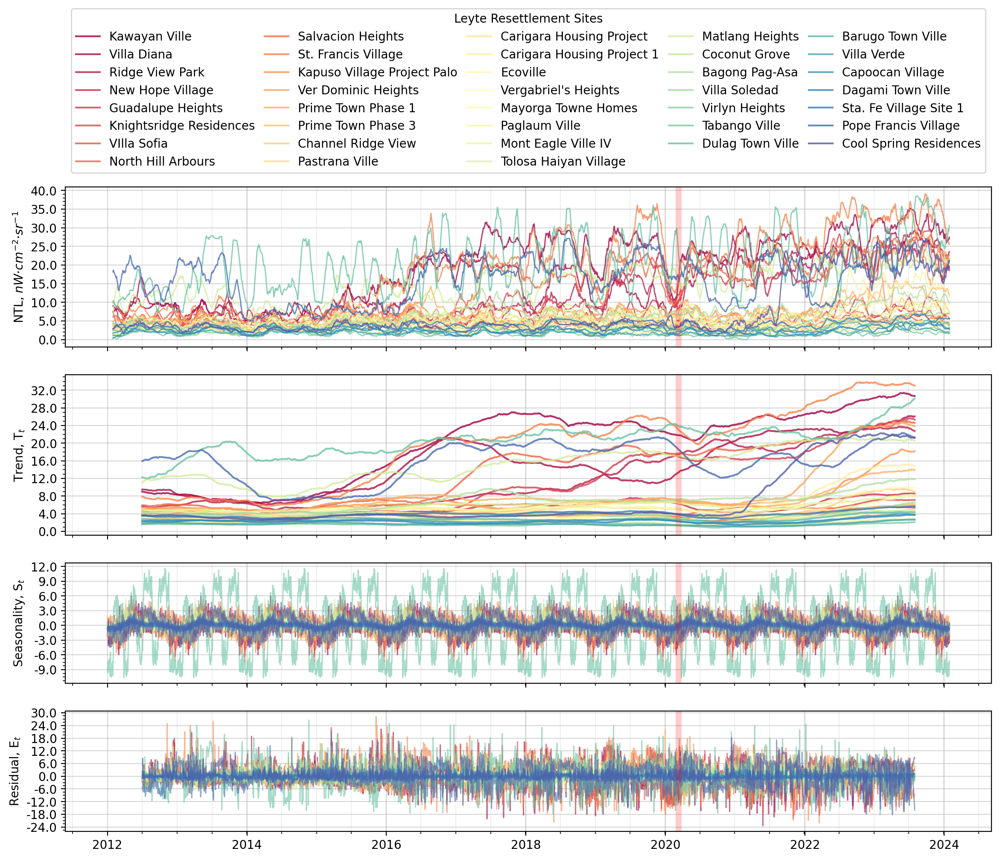

  8%|███▌                                        | 2/25 [00:09<01:57,  5.11s/it]

Processing Samar
Processing St. Genevieve Village
Processing St. Genevieve Site 1/ 2
Processing Eastwind Residences
Processing Samar Forestdale I
Processing Balangiga Town Ville
Processing Hernani Town Ville
Processing Quinapondan Town Ville
Processing Gen. MacArthur Townville
Processing Mont Peak Estate
Processing Salcedo Housing Project
Processing Rondale Residences
Processing Giporlos Greenfields


  8%|███▌                                        | 2/25 [00:10<02:03,  5.39s/it]

Processing San Lorenzo Residences
Processing Basey Point/Point 2A
Processing nan


KeyError: nan

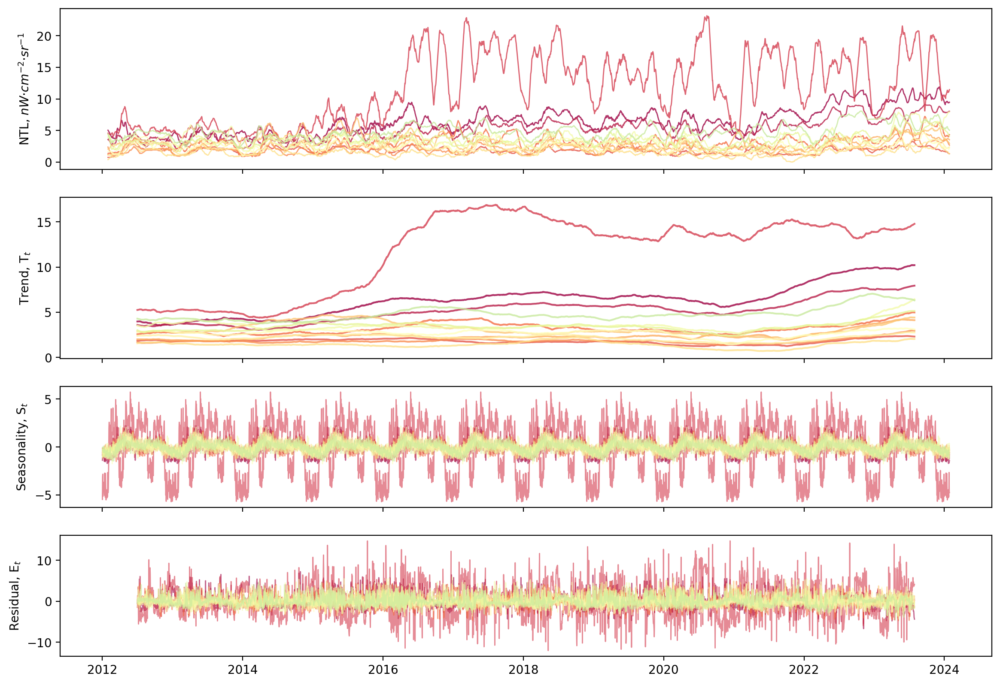

In [101]:
provinces = df_resettlement['Province'].unique()

for province in tqdm(provinces):
    print('Processing ' + str(province))
    sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].unique()
    fig, ax = plt.subplots(nrows=4,ncols=1, sharex='col',
                      gridspec_kw={'height_ratios':[2,2,1.5,1.5]},
                      figsize=(14,10), dpi = 200)
    
    for i, site in enumerate(sites):
        print('Processing ' + str(site))
        data = NTL_STL['Raw'][site].rolling(30).mean()
        line_color = plt.cm.Spectral(i/len(sites))
        ax[0].plot(date_range, data, color = line_color, linewidth = 1, alpha = 0.8)
        ax[0].set_ylabel('NTL, $nW ·cm^{−2}·sr^{−1}$')

        ax[1].plot(date_range, NTL_STL['Trend'][site], color = line_color,
                alpha = 0.8, label= sites[i])
        ax[1].set_ylabel('Trend, T$_t$')

        ax[2].plot(date_range, NTL_STL['Seasonality'][site], color = line_color,
                linewidth = 1, alpha = 0.6)
        ax[2].set_ylabel('Seasonality, S$_t$')

        ax[3].plot(date_range, NTL_STL['Residual'][site], color = line_color,
            linewidth = 1, alpha = 0.6)
        ax[3].set_ylabel('Residual, E$_t$')

    ax[1].legend(fontsize=10, ncol = 5, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
                bbox_transform=ax[0].transAxes, fancybox = True, mode='expand', 
                title = str(province) + ' Resettlement Sites')

    for ax in ax:
        ax.grid(alpha = 0.5)
        ax.axvline(datetime.date(2020, 3, 10), color = 'r', lw = 5, alpha = 0.2) #For COVID lockdown
        ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f')) # 2 decimal places)
        ax.minorticks_on()
        ax.xaxis.grid(True, which='minor', alpha = 0.2) 
        ax.yaxis.set_major_locator(MaxNLocator(integer=True))

    dtFmt = mdates.DateFormatter('%Y') # define the formatting
    plt.gca().xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis
    plt.tight_layout()
    plt.savefig(results_path+str(province)+".png", bbox_inches="tight")
    plt.show()

  0%|                                                    | 0/25 [00:00<?, ?it/s]

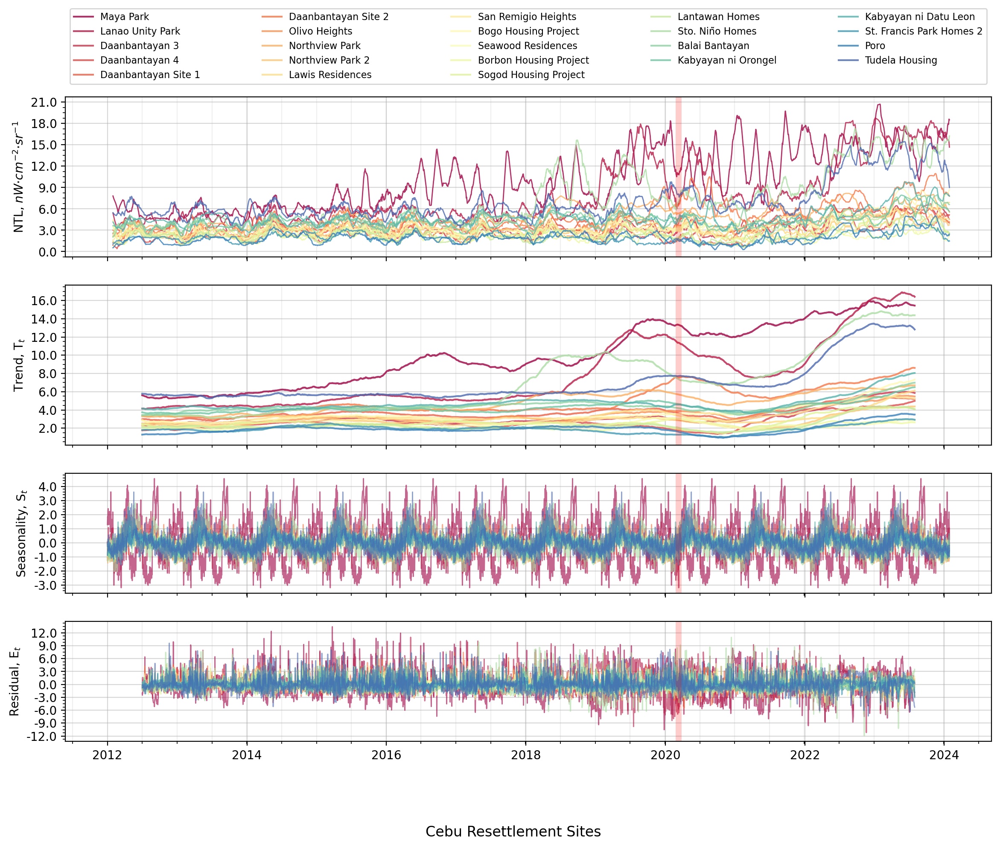

  4%|█▊                                          | 1/25 [00:04<01:42,  4.29s/it]

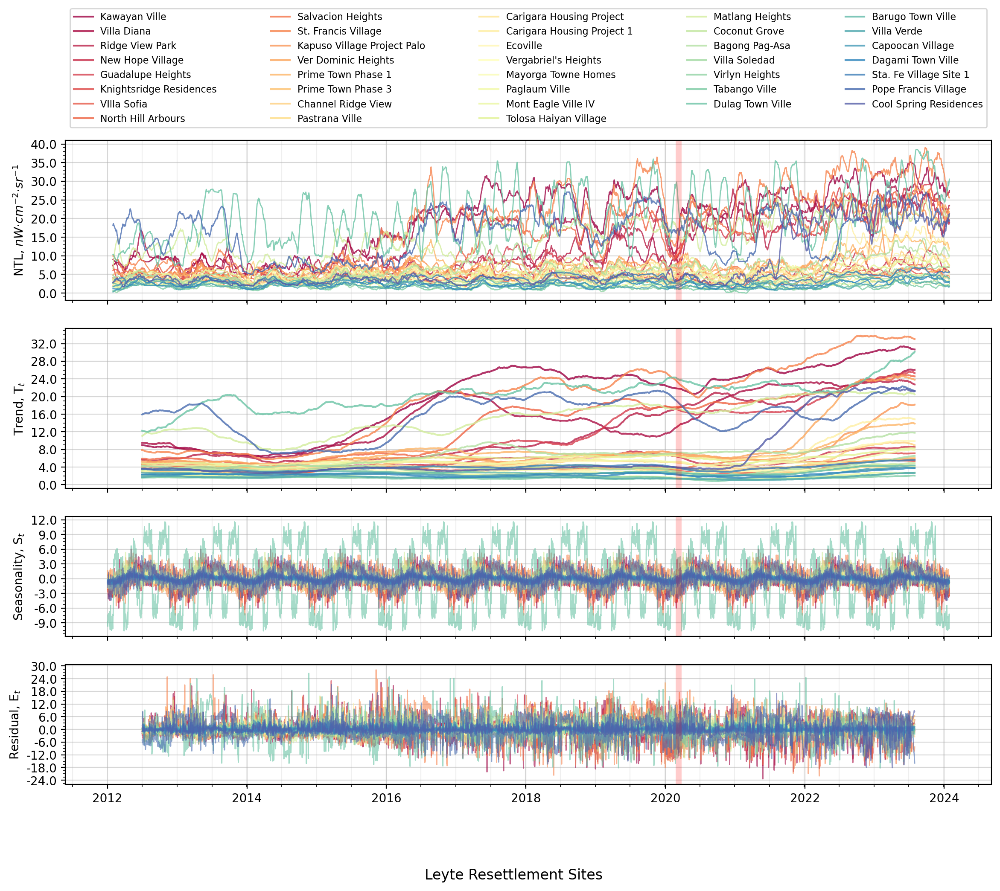

  8%|███▌                                        | 2/25 [00:11<02:12,  5.78s/it]


KeyError: nan

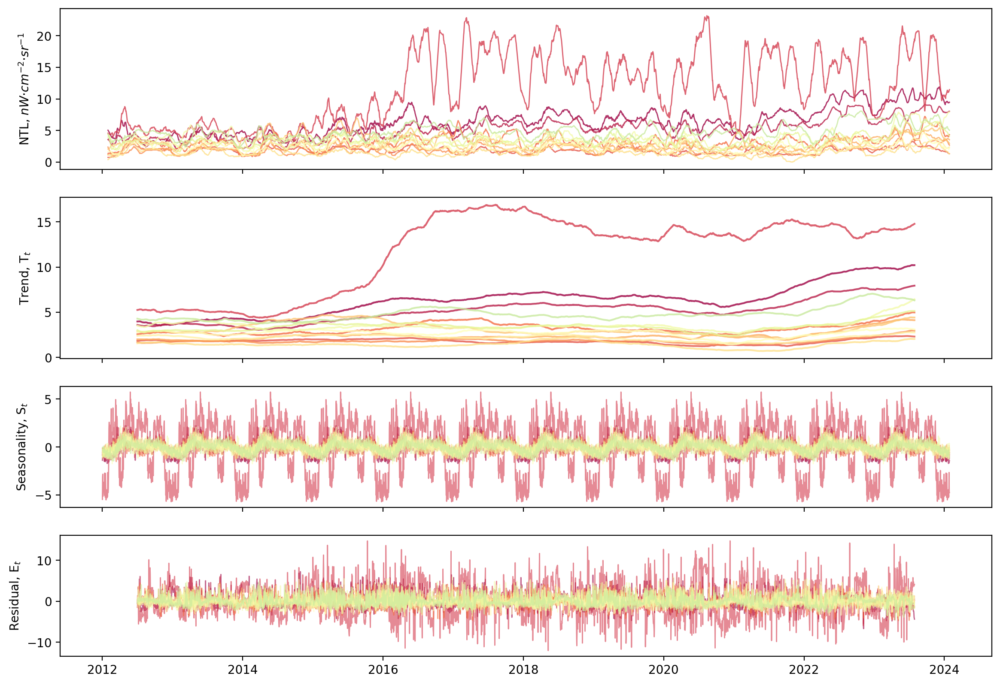

In [99]:
import numpy as np
from tqdm import tqdm

# Assuming your DataFrame is named 'df_resettlement'
provinces = df_resettlement['Province'].unique()

for province in tqdm(provinces):
    # Skip if the province is nan
    if pd.notna(province):
        sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].unique()
        fig, ax = plt.subplots(nrows=4, ncols=1, sharex='col',
                               gridspec_kw={'height_ratios': [2, 2, 1.5, 1.5]},
                               figsize=(14, 10), dpi=200)

        for i, site in enumerate(sites):
            data = NTL_STL['Raw'][site].rolling(30).mean()
            line_color = plt.cm.Spectral(i / len(sites))
            ax[0].plot(date_range, data, color=line_color, linewidth=1, alpha=0.8)
            ax[0].set_ylabel('NTL, $nW ·cm^{−2}·sr^{−1}$')

            ax[1].plot(date_range, NTL_STL['Trend'][site], color=line_color,
                       alpha=0.8, label=sites[i])
            ax[1].set_ylabel('Trend, T$_t$')

            ax[2].plot(date_range, NTL_STL['Seasonality'][site], color=line_color,
                       linewidth=1, alpha=0.6)
            ax[2].set_ylabel('Seasonality, S$_t$')

            ax[3].plot(date_range, NTL_STL['Residual'][site], color=line_color,
                       linewidth=1, alpha=0.6)
            ax[3].set_ylabel('Residual, E$_t$')

        ax[1].legend(fontsize=8, ncol=5, bbox_to_anchor=(0, 1.05, 1, 0.5), loc="lower left",
                     bbox_transform=ax[0].transAxes, fancybox=True, mode='expand')

        for ax in ax:
            ax.grid(alpha=0.5)
            ax.axvline(datetime.date(2020, 3, 10), color='r', lw=5, alpha=0.2)  # For COVID lockdown
            ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f'))  # 2 decimal places)
            ax.minorticks_on()
            ax.xaxis.grid(True, which='minor', alpha=0.2)
            ax.yaxis.set_major_locator(MaxNLocator(integer=True))

        dtFmt = mdates.DateFormatter('%Y')  # define the formatting
        plt.gca().xaxis.set_major_formatter(dtFmt)  # apply the format to the desired axis
        fig.supxlabel(str(province) + ' Resettlement Sites')
        plt.tight_layout()
        plt.savefig(results_path + str(province) + ".png", bbox_inches="tight")
        plt.show()


In [48]:
len(sites)

23

Processing: 100%|███████████████████████████████| 23/23 [00:01<00:00, 19.32it/s]


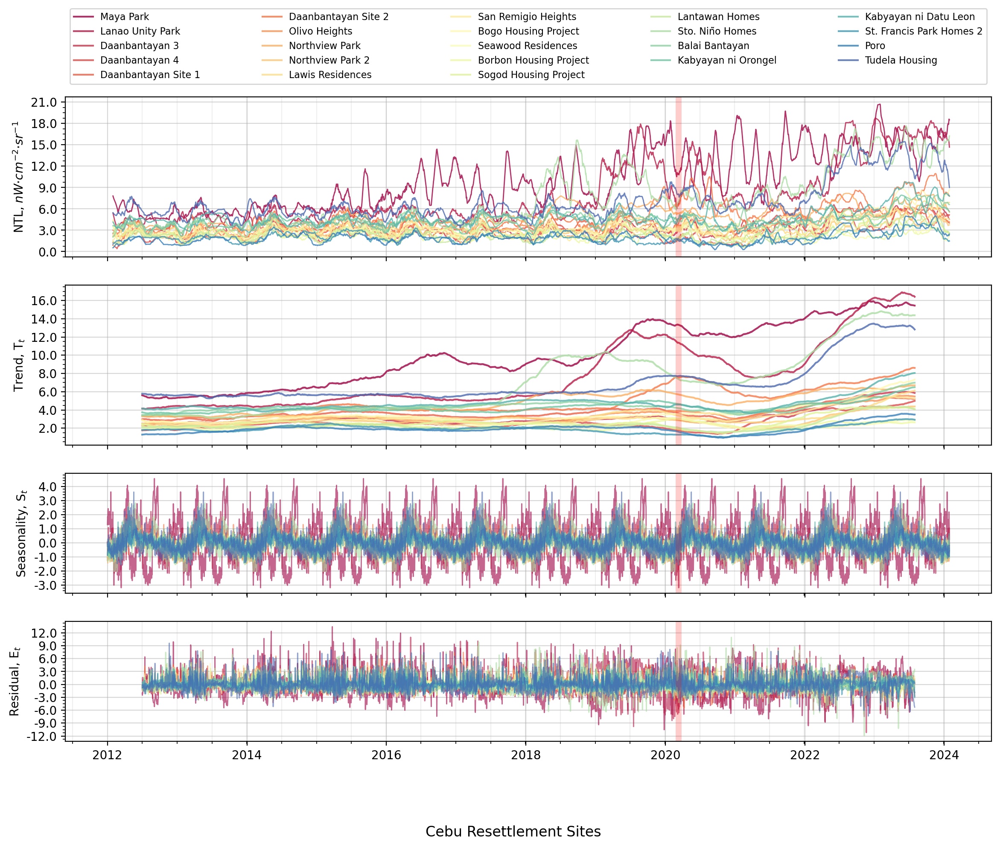

In [86]:
fig, ax = plt.subplots(nrows=4,ncols=1, sharex='col',
                      gridspec_kw={'height_ratios':[2,2,1.5,1.5]},
                      figsize=(14,10), dpi = 200)


for i in tqdm(range(len(sites)), desc = 'Processing: '):
              
    data = NTL_STL['Raw'].iloc[:,i].rolling(30).mean()
    line_color = plt.cm.Spectral(i/len(sites))
    ax[0].plot(date_range, data, color = line_color, linewidth = 1, alpha = 0.8)
    ax[0].set_ylabel('NTL, $nW ·cm^{−2}·sr^{−1}$')

    ax[1].plot(date_range, NTL_STL['Trend'].iloc[:,i], color = line_color,
            alpha = 0.8, label= sites[i])
    ax[1].set_ylabel('Trend, T$_t$')

    ax[2].plot(date_range, NTL_STL['Seasonality'].iloc[:,i], color = line_color,
            linewidth = 1, alpha = 0.6)
    ax[2].set_ylabel('Seasonality, S$_t$')

    residual = NTL_STL['Residual'].iloc[:,i]
    ax[3].plot(date_range, NTL_STL['Residual'].iloc[:,i], color = line_color,
        linewidth = 1, alpha = 0.6)
    ax[3].set_ylabel('Residual, E$_t$')

ax[1].legend(fontsize=8, ncol = 5, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
            bbox_transform=ax[0].transAxes, fancybox = True, mode='expand')

for ax in ax:
    ax.grid(alpha = 0.5)
    ax.axvline(datetime.date(2020, 3, 10), color = 'r', lw = 5, alpha = 0.2) #For COVID lockdown
    ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.1f')) # 2 decimal places)
    ax.minorticks_on()
    ax.xaxis.grid(True, which='minor', alpha = 0.2) 
    ax.yaxis.set_major_locator(MaxNLocator(integer=True))

dtFmt = mdates.DateFormatter('%Y') # define the formatting
plt.gca().xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis
fig.supxlabel(str(province) + ' Resettlement Sites')

plt.tight_layout()
plt.show()

In [ ]:
def STL_extraction(province, code, period):

#     region = str(reg_names[reg_codes.index(code)])

#     print("Processing NTL extraction for resettlements in " + str(province) + " Province, " + str(region))
    NTL_dataset = NTL_dataset_initialize(province, code)

    prov_df = df.loc[df['Province']==province,:]
    prov_df = prov_df.reset_index(drop=True)
    prov_df.index = prov_df.index + 1


    for i in tqdm(range(1,len(prov_df)+1), desc = region + ": Processing"):
      NTL_data = time_series_(prov_df['Latitude'][i], prov_df['Longitude'][i], prov_df['Buffer'][i])
      NTL_data.index = pd.to_datetime(NTL_data.index)
      idx = pd.date_range(start="2014-01-01",end="2023-09-01", freq='MS')
      NTL_data = NTL_data.reindex(idx)
      NTL_data = NTL_data.interpolate(limit_direction='both')
      NTL_dataset.insert(i+1, prov_df['Project Name'][i], NTL_data)

    trend = NTL_dataset.copy()
    seasonality = NTL_dataset.copy()
    residual = NTL_dataset.copy()

    for loc in tqdm(NTL_dataset.columns, desc = 'STL Decomposition'):
      data = NTL_dataset[loc].values
      decomposition = sm.tsa.seasonal_decompose(data, model='additive', period = period)
      trend[loc] = decomposition.trend
      seasonality[loc] = decomposition.seasonal
      residual[loc] = decomposition.resid

    dataframe = pd.concat([NTL_dataset,trend, seasonality, residual], axis = 1, keys = ['Raw', 'Trend', 'Seasonality', 'Residual'])
    return dataframe

# STL_extraction(province = 'Laguna', code = 67166, period = 12)

In [347]:
def visualize_ts(dataframe):
    fig, ax = plt.subplots(dpi = 200, figsize = (12,4))
    fig.patch.set_facecolor('None')
    
    palette = sns.color_palette('gnuplot2', len(dataframe.columns))

    dataframe.plot(ax=ax, marker='o', markersize=1, linestyle='-', linewidth=0.5, color = palette)
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)
    plt.legend(fontsize=8, ncol = 5, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
                    bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand')

    plt.ylim(0,30)
#     plt.show()

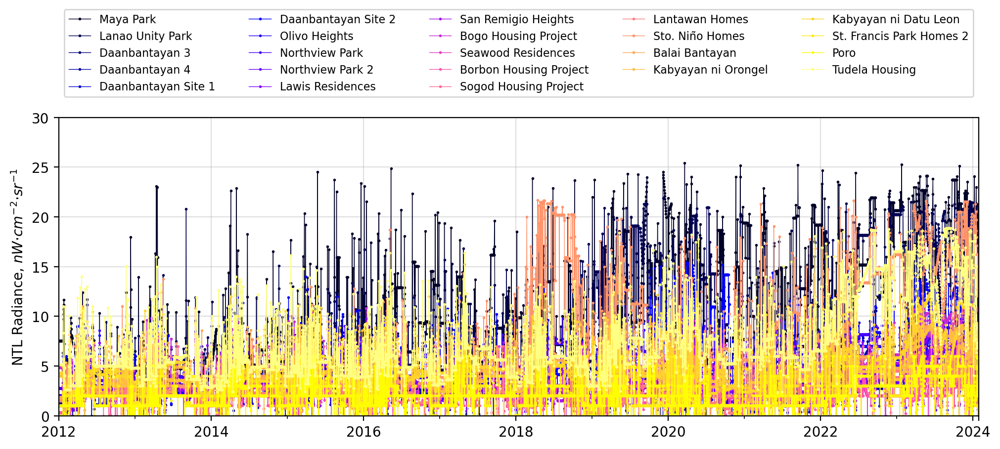

In [348]:
visualize_ts(NTL_dataframe[sites])

In [334]:
df_NTL_resettlement.loc[:, ('Cebu', slice(None))]

Province               Cebu                                                 \
Resettlement Site Maya Park Lanao Unity Park Daanbantayan 3 Daanbantayan 4   
2012-01-01              NaN              NaN            NaN            NaN   
2012-01-02              NaN              NaN            NaN            NaN   
2012-01-03              NaN              NaN            NaN            NaN   
2012-01-04              NaN              NaN            NaN            NaN   
2012-01-05              NaN              NaN            NaN            NaN   
...                     ...              ...            ...            ...   
2024-01-24              NaN              NaN            NaN            NaN   
2024-01-25              NaN              NaN            NaN            NaN   
2024-01-26              NaN              NaN            NaN            NaN   
2024-01-27              NaN              NaN            NaN            NaN   
2024-01-28              NaN              NaN            NaN            NaN   

Province                                                                 \
Resettlement Site Daanbantayan Site 1 Daanbantayan Site 2 Olivo Heights   
2012-01-01                        NaN                 NaN           NaN   
2012-01-02                        NaN                 NaN           NaN   
2012-01-03                        NaN                 NaN           NaN   
2012-01-04                        NaN                 NaN           NaN   
2012-01-05                        NaN                 NaN           NaN   
...                               ...                 ...           ...   
2024-01-24                        NaN                 NaN           NaN   
2024-01-25                        NaN                 NaN           NaN   
2024-01-26                        NaN                 NaN           NaN   
2024-01-27                        NaN                 NaN           NaN   
2024-01-28                        NaN                 NaN           NaN   

Province                                                             ...  \
Resettlement Site Northview Park Northview Park 2 Lawis Residences   ...   
2012-01-01                   NaN              NaN               NaN  ...   
2012-01-02                   NaN              NaN               NaN  ...   
2012-01-03                   NaN              NaN               NaN  ...   
2012-01-04                   NaN              NaN               NaN  ...   
2012-01-05                   NaN              NaN               NaN  ...   
...                          ...              ...               ...  ...   
2024-01-24                   NaN              NaN               NaN  ...   
2024-01-25                   NaN              NaN               NaN  ...   
2024-01-26                   NaN              NaN               NaN  ...   
2024-01-27                   NaN              NaN               NaN  ...   
2024-01-28                   NaN              NaN               NaN  ...   

Province                                                         \
Resettlement Site Southville 9 Northville 2A Dinalungan Heights   
2012-01-01                 NaN           NaN                NaN   
2012-01-02                 NaN           NaN                NaN   
2012-01-03                 NaN           NaN                NaN   
2012-01-04                 NaN           NaN                NaN   
2012-01-05                 NaN           NaN                NaN   
...                        ...           ...                ...   
2024-01-24                 NaN           NaN                NaN   
2024-01-25                 NaN           NaN                NaN   
2024-01-26                 NaN           NaN                NaN   
2024-01-27                 NaN           NaN                NaN   
2024-01-28                 NaN           NaN                NaN   

Province                                                                       \
Resettlement Site San Luis Villas Dinalungan Res Tuba Res Badat Bin

<AxesSubplot:>

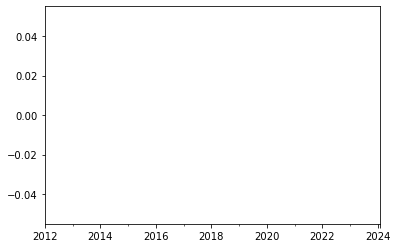

In [336]:
df_NTL_resettlement['Cebu', 'Maya Park'].plot()